In [1]:
import numpy as np 
import matplotlib.pyplot as plt 
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
plt.style.use('classic')


In [2]:
class Gaussian_Wave:
    
    def __init__(self, N_grid, L, a, V0, w, x0, k0,sigma,t):
        
        self.t=t
        self.L=L
        self.N_grid = N_grid
        
        self.x = np.linspace(0,self.L,self.N_grid+1) #grid of points
        self.dx = self.x[1]-self.x[0] #grid point spacing or 'discrete' analogue of the differential length
        
        
        def integral(f,axis = 0):
            """This function allows us to approximate integrals in discrete space"""
            return np.sum(f*self.dx, axis = axis)
        
        
        self.Psi0  = np.exp( -1/2* (self.x[1:-1]-x0)**2/sigma**2) *np.exp(1j*k0*self.x[1:-1]) 
        #use this range for x because as mentionned, we need the wavefunction to be 0 at the endpoints of the grid. 
        
        
        #normalise the initial state
        norm  = integral(np.abs(self.Psi0)**2)
        self.Psi0 = self.Psi0/np.sqrt(norm)
        
        #kinetic energy
        self.T = -1/2 * 1/self.dx**2 * (np.diag(-2*np.ones(self.N_grid-1))+ np.diag(np.ones(self.N_grid-2),1)+ np.diag(np.ones(self.N_grid-2),-1))
        print(self.T.shape)
        
        #potential as a flat array
        self.V_flat = np.array([V0 if a< pos < a+w else -0.01 for pos in self.x[1:-1]])
        
        #potential energy as a diagonal matrix
        self.V = np.diag(self.V_flat)
        
        #Hamiltonian
        self.H = self.T+self.V
        
        
    #solve the eigenvalue problem and get the time-dependent wavefunction   
    def animation(self):
        
        
        def integral(f,axis = 0):
            """This function allows us to approximate integrals in discrete space"""
            return np.sum(f*self.dx, axis = axis)
            
            
        #get eigenvalues and eigenvectors and normalise
        E, psi = np.linalg.eigh(self.H)
        psi = psi.T
        norm = integral(np.abs(psi)**2)
        psi = psi/np.sqrt(norm)

        #get expansion coeffs
        c_n = np.zeros_like(psi[0], dtype=complex)
        for j in range(0, self.N_grid-1):

            c_n[j] = integral(np.conj(psi[j]) * self.Psi0) #for each eigenvector, compute the inner product

        #get a function that returns the time dependent wavefunction
        def Psi(t):
            
            return psi.T@(c_n*np.exp(-1j*E*t))





        fig = plt.figure(figsize = (20,12))
        ax = plt.axes(xlim=(0, self.L), ylim=(-0.25, 0.25))
        line, = ax.plot([], [], lw=2)
        ax.plot(self.x[1:-1],self.V_flat, label = '$V(x)$')
        ax.set_title('Gaussian wave packet with a potential barrier', fontsize = 20)
        line1, = ax.plot(self.x[1:-1],np.zeros(self.N_grid-1),lw=2,color="red", label = r'$\Re(\psi)$')
        line2, = ax.plot(self.x[1:-1],np.zeros(self.N_grid-1),lw=2,color="blue", label = r'$\Im(\psi)$')
        ax.legend(fontsize = 15)
        ax.set_xlabel('$x$', fontsize = 15)

        def animate(t):

            y1 = np.real(Psi(t))
            y2 = np.imag(Psi(t))
            line1.set_data(self.x[1:-1],y1)  
            line2.set_data(self.x[1:-1], y2)

            return (line1, line2,)


        def init():
            line1.set_data([],[])  
            line2.set_data([], [])
            return (line1,line2,)

        ani = FuncAnimation(fig, animate, len(self.t), init_func=init,
                                      interval=20, blit=False)
        
        return ani

(749, 749)


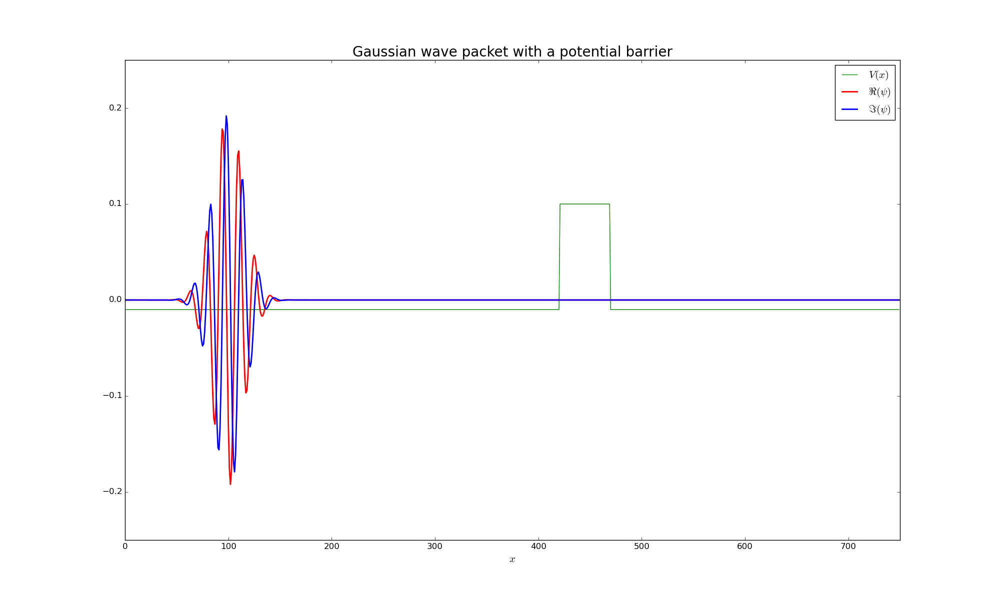

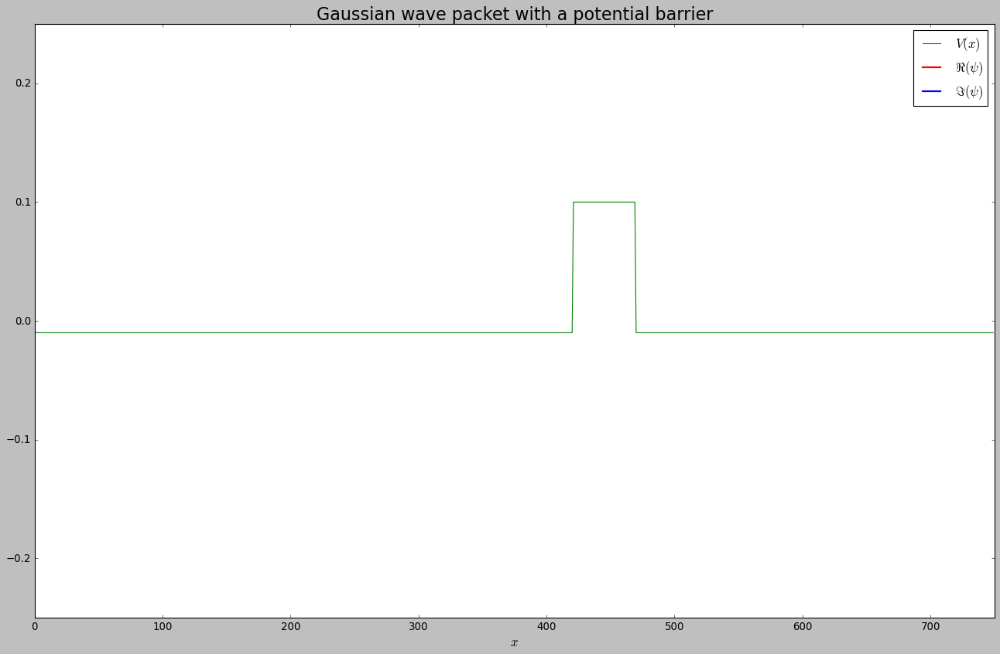

In [3]:
#plt.rcParams['animation.embed_limit'] = 500.0
wavepacket = Gaussian_Wave(750,750, 420,0.1,50,100,0.4,15, np.linspace(0.,2500,1000))
Psi = wavepacket.animation()
#HTML(Psi.to_jshtml())
from matplotlib.animation import PillowWriter
Psi.save("wave.gif", writer=PillowWriter(fps=10))
from IPython.display import Image
Image(filename="wave.gif")